# Italian Airports Network - Performance Analysis since 2000  
  
  <br/><br/>

![](images/00_cover.gif?raw=true)

## 01. Exploratory Data Analysis  
  
  <br/><br/>

This is a personal project that aims to analyze the performance of Italian airports in terms of key operational metrics: aircraft movements, passenger traffic, and freight throughput.  
By examining historical data (starting from the year 2000) and identifying trends, my goal is to gain insights into the efficiency, capacity, and potential areas for improvement of different airports.  
  
  The primary data source for this analysis is [Assaeroporti](https://assaeroporti.com/), the association of Italian airport operators, which collect historical records on aircraft movements, passenger numbers, and freight tonnage.  
  
  After the data collection, I collated and cleaned the different datasets before enriching them with the IATA code and the geographic area for each airport.  
Before performing EDA, there are other potential features that can be added to the dataset:
- potential catchment area (30 minutes, 60 minutes distance)
- distance from closest motorway exit
- distance from closest railway station
  
  <br/><br/>
  

## Libraries Import

In [1]:
import pandas as pd
import numpy as np
import warnings
import glob
import os

import sys
import geopandas as gpd
from tqdm import tqdm

In [2]:
import folium
import matplotlib.pyplot as plt
import matplotlib.ticker as tkr
import seaborn as sns

plt.style.use('fivethirtyeight')
sns.set(font_scale=0.8)

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

In [3]:
# run to avoid warnings
warnings.filterwarnings('ignore')

## Data Loading

In [4]:
# load the data from the final CSV, using the previous Date column as index 
df = pd.read_csv('datasets/final/df_fin.csv', index_col='Date', parse_dates=True)

In [5]:
df

,Airport,Code,Geographic Area,Dimension,Latitude,Longitude,Month,Year,MOV - Domestic,MOV - International,...,PAX - Domestic,PAX - International,PAX - EU,PAX - Transit,PAX - General Avio,PAX - Total,FRE - Goods Avio,FRE - Goods Ground,FRE - Mail,FRE - Total
Date,,,,,,,,,,,,,,,,,,,,,
2000-01-01,Alghero,AHO,Islands,Small,40.6306,8.2954,1,2000,515.0,25.0,...,30634.0,799.0,0.0,0.0,0.0,31433.0,59.000,0.0000,74.000,133.0000
2000-01-01,Ancona,AOI,Central-East,Small-Medium,43.6068,13.3551,1,2000,476.0,346.0,...,18183.0,12098.0,7056.0,61.0,656.0,30998.0,232.000,2.0000,68.000,302.0000
2000-01-01,Bari,BRI,South,Medium-Large,41.1343,16.7635,1,2000,1437.0,77.0,...,82936.0,1217.0,0.0,68.0,110.0,84331.0,168.000,0.0000,193.000,361.0000
2000-01-01,Bergamo,BGY,North-West,Large,45.6657,9.6989,1,2000,770.0,2302.0,...,38403.0,48697.0,25666.0,653.0,189.0,87942.0,7139.000,80.0000,1.000,7220.0000
2000-01-01,Bologna,BLQ,North-East,Medium-Large,44.5295,11.2930,1,2000,1379.0,3108.0,...,67923.0,150338.0,120214.0,5424.0,307.0,223992.0,945.000,422.0000,255.000,1622.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-08-01,Trapani,TPS,Islands,Medium,37.9017,12.4959,8,2024,635.0,308.0,...,90896.0,53226.0,46540.0,125.0,181.0,144428.0,0.000,0.0000,0.000,0.0000
2024-08-01,Treviso,TSF,North-East,Medium,45.6547,12.2046,8,2024,58.0,1610.0,...,8858.0,286104.0,227946.0,180.0,281.0,295423.0,0.000,0.0000,0.000,0.0000
2024-08-01,Trieste,TRS,North-East,Medium,45.8213,13.4854,8,2024,556.0,446.0,...,68278.0,64413.0,53494.0,24.0,206.0,132921.0,6.249,0.2630,0.000,6.5120


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 10997 entries, 2000-01-01 to 2024-08-01
Data columns (total 23 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Airport              10997 non-null  object 
 1   Code                 10997 non-null  object 
 2   Geographic Area      10997 non-null  object 
 3   Dimension            10997 non-null  object 
 4   Latitude             10997 non-null  float64
 5   Longitude            10997 non-null  float64
 6   Month                10997 non-null  int64  
 7   Year                 10997 non-null  int64  
 8   MOV - Domestic       10953 non-null  float64
 9   MOV - International  10953 non-null  float64
 10  MOV - EU             10917 non-null  float64
 11  MOV - General Avio   10953 non-null  float64
 12  MOV - Total          10953 non-null  float64
 13  PAX - Domestic       10953 non-null  float64
 14  PAX - International  10953 non-null  float64
 15  PAX - EU           

In [7]:
# display a table containing the main features of all airports
df_sub = df[['Airport', 'Code', 'Geographic Area', 'Dimension', 'Latitude', 'Longitude']]
df_tab = df_sub.drop_duplicates('Airport', keep='first').sort_values(by = 'Airport')
df_tab.reset_index(drop=True, inplace=True)
df_tab.index +=1
df_tab

,Airport,Code,Geographic Area,Dimension,Latitude,Longitude
1,Alghero,AHO,Islands,Small,40.6306,8.2954
2,Ancona,AOI,Central-East,Small-Medium,43.6068,13.3551
3,Bari,BRI,South,Medium-Large,41.1343,16.7635
4,Bergamo,BGY,North-West,Large,45.6657,9.6989
5,Bologna,BLQ,North-East,Medium-Large,44.5295,11.2930
6,Bolzano,BZO,North-East,Small,46.4625,11.3298
7,Brescia,VBS,North-West,Small-Medium,45.4256,10.3268
8,Brindisi,BDS,South,Medium,40.6578,17.9391
9,Cagliari,CAG,Islands,Medium-Large,39.2540,9.0605
10,Catania,CTA,Islands,Large,37.4700,15.0666


In [8]:
# display an interactive map of Italy containing airports
fig_01 = folium.Figure(width=980, height=980)

# set scroll limits
min_lat, max_lat = 21.90, 57.40
min_lon, max_lon = -12.15, 36.75

italy_map = folium.Map(location=(41.8719, 12.5674), tiles='Stadia.StamenTonerLite', zoom_start=6, max_bounds=True,
                       min_lat=min_lat, max_lat=max_lat, min_lon=min_lon, max_lon=max_lon).add_to(fig_01)
for index, row in df_tab.iterrows():
    folium.Marker(location=[row['Latitude'], row['Longitude']],
                  popup=row['Airport'] + ' Airport',
                  icon=folium.Icon(icon='plane', prefix='fa', color='red')).add_to(italy_map)

# folium.CircleMarker([max_lat, min_lon], tooltip="Upper Left Corner").add_to(italy_map)
# folium.CircleMarker([min_lat, min_lon], tooltip="Lower Left Corner").add_to(italy_map)
# folium.CircleMarker([min_lat, max_lon], tooltip="Lower Right Corner").add_to(italy_map)
# folium.CircleMarker([max_lat, max_lon], tooltip="Upper Right Corner").add_to(italy_map)    
    
fig_01

In [9]:
# load the map of Italy with regions
italy = gpd.read_file('maps/italy-with-regions/reg2011_g.shp')

In [10]:
italy

,COD_REG,NOME_REG,SHAPE_Leng,SHAPE_Area,geometry
0,1,PIEMONTE,1.236869e+06,2.539410e+10,"POLYGON ((457832.312 5145701, 458745.249 51444..."
1,2,VALLE D'AOSTA/VALLÉE D'AOSTE\r\nVALLE D'AOSTA/...,3.111651e+05,3.259041e+09,"POLYGON ((390734.999 5091965.001, 390830.999 5..."
2,3,LOMBARDIA,1.411265e+06,2.386270e+10,"MULTIPOLYGON (((595736.187 5163715.001, 596126..."
3,4,TRENTINO-ALTO ADIGE/SUDTIROL,8.005341e+05,1.360802e+10,"POLYGON ((743386.08 5219948.9, 743472.19 52199..."
4,5,VENETO,1.057856e+06,1.840550e+10,"POLYGON ((768209.001 5175597.001, 768220.251 5..."
5,6,FRIULI VENEZIA GIULIA,6.674897e+05,7.864294e+09,"MULTIPOLYGON (((852211.994 5080672.916, 852270..."
6,7,LIGURIA,8.342245e+05,5.415465e+09,"MULTIPOLYGON (((400403.625 4851436.938, 400257..."
7,8,EMILIA-ROMAGNA,1.164723e+06,2.245147e+10,"MULTIPOLYGON (((760714.748 4937319.399, 760723..."
8,9,TOSCANA,1.316658e+06,2.298443e+10,"MULTIPOLYGON (((593650.25 4867988, 593553 4868..."
9,10,UMBRIA,6.203152e+05,8.464008e+09,"MULTIPOLYGON (((771407.451 4833282.073, 771402..."


<AxesSubplot:>

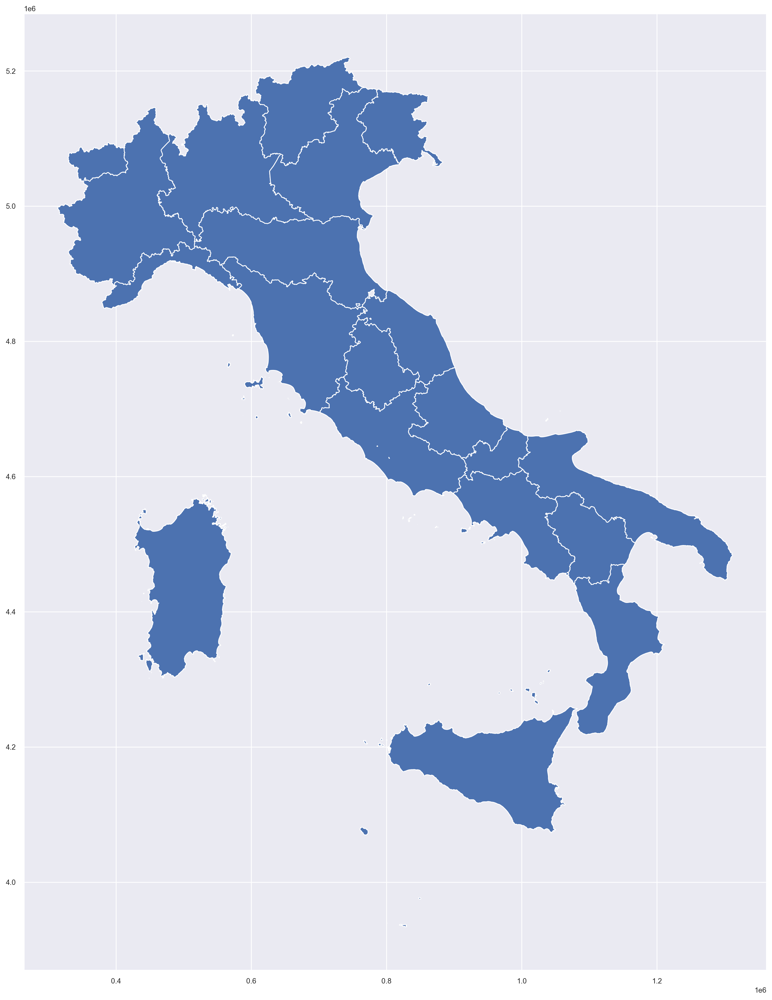

In [11]:
italy.plot(figsize = (20,20))

## description to be added  
  
   <br/><br/>






In [12]:
# define subsets for national annual aircraft movements
mov_dom_year = df.groupby('Year')['MOV - Domestic'].sum().reset_index()
mov_int_year = df.groupby('Year')['MOV - International'].sum().reset_index()
mov_EU_year = df.groupby('Year')['MOV - EU'].sum().reset_index()
mov_gen_year = df.groupby('Year')['MOV - General Avio'].sum().reset_index()
mov_tot_year = df.groupby('Year')['MOV - Total'].sum().reset_index()

# define subsets for national annual passengers 
pax_dom_year = df.groupby('Year')['PAX - Domestic'].sum().reset_index()
pax_int_year = df.groupby('Year')['PAX - International'].sum().reset_index()
pax_EU_year = df.groupby('Year')['PAX - EU'].sum().reset_index()
pax_trs_year = df.groupby('Year')['PAX - Transit'].sum().reset_index()
pax_gen_year = df.groupby('Year')['PAX - General Avio'].sum().reset_index()
pax_tot_year = df.groupby('Year')['PAX - Total'].sum().reset_index()

# define subsets for national annual freight
fre_avio_year = df.groupby('Year')['FRE - Goods Avio'].sum().reset_index()
fre_grnd_year = df.groupby('Year')['FRE - Goods Ground'].sum().reset_index()
fre_mail_year = df.groupby('Year')['FRE - Mail'].sum().reset_index()
fre_tot_year = df.groupby('Year')['FRE - Total'].sum().reset_index()

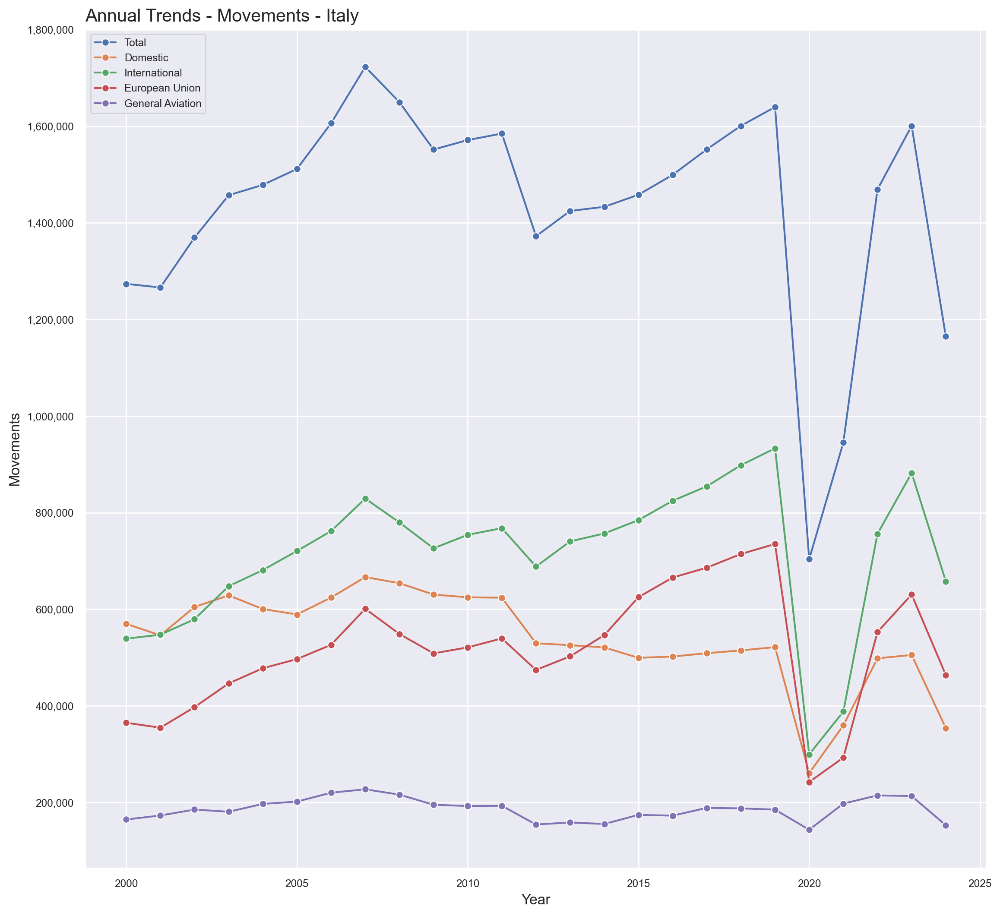

In [13]:
# plot the time series for annual movements
fig, ax = plt.subplots(figsize = (12,12))
plt.title('Annual Trends - Movements - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Movements', fontsize = 12)
plt.xlabel('Year', fontsize = 12)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

sns.lineplot(data=mov_tot_year, x='Year', y='MOV - Total', marker='o', label='Total')
sns.lineplot(data=mov_dom_year, x='Year', y='MOV - Domestic', marker='o', label='Domestic')
sns.lineplot(data=mov_int_year, x='Year', y='MOV - International', marker='o', label='International')
sns.lineplot(data=mov_EU_year, x='Year', y='MOV - EU', marker='o', label='European Union')
sns.lineplot(data=mov_gen_year, x='Year', y='MOV - General Avio', marker='o', label='General Aviation')

plt.legend(loc="upper left")
plt.show()

The movements concerning the **European Union** are a subset of the **International** ones and both follow a similar pattern.  
**Domestic** movements were the highest segment in 2000, peaked in 2007 but declined after 2011.  
The movements concerning **General Aviation** are significantly lower than the other segments as expected.  
The negative impact of COVID is clearly visible for every segment during the years 2020 and 2021.  
  
  <br/><br/>

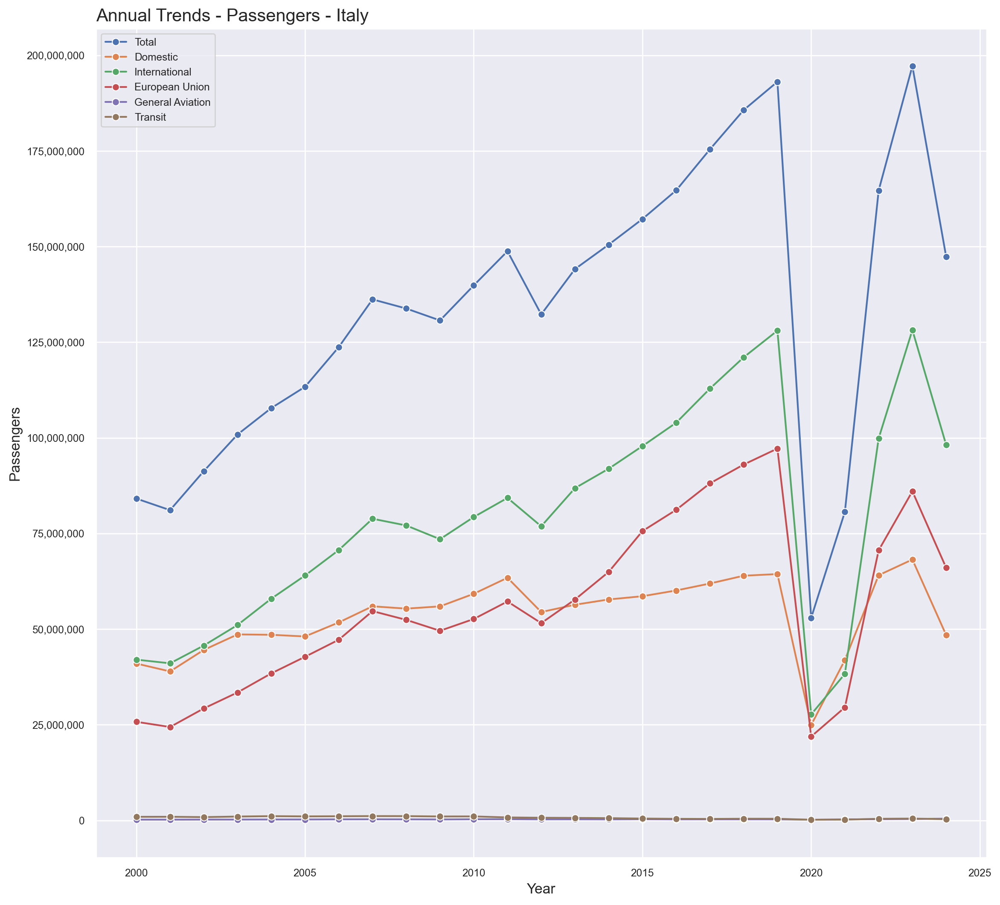

In [14]:
# plot the time series for annual passengers
fig, ax = plt.subplots(figsize = (12,12))
plt.title('Annual Trends - Passengers - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Passengers', fontsize = 12)
plt.xlabel('Year', fontsize = 12)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

sns.lineplot(data=pax_tot_year, x='Year', y='PAX - Total', marker='o', label='Total')
sns.lineplot(data=pax_dom_year, x='Year', y='PAX - Domestic', marker='o', label='Domestic')
sns.lineplot(data=pax_int_year, x='Year', y='PAX - International', marker='o', label='International')
sns.lineplot(data=pax_EU_year, x='Year', y='PAX - EU', marker='o', label='European Union')
sns.lineplot(data=pax_gen_year, x='Year', y='PAX - General Avio', marker='o', label='General Aviation')
sns.lineplot(data=pax_trs_year, x='Year', y='PAX - Transit', marker='o', label='Transit')

plt.show()

The passengers concerning the **European Union** are a subset of the **International** ones and both follow a similar pattern.  
**Domestic** passengers numbers remained similar to the **International** ones until 2003, when they started to diverge and became half of the latter.  
The negative impact of COVID is clearly visible for every segment during the years 2020 and 2021.  
  
  <br/><br/>

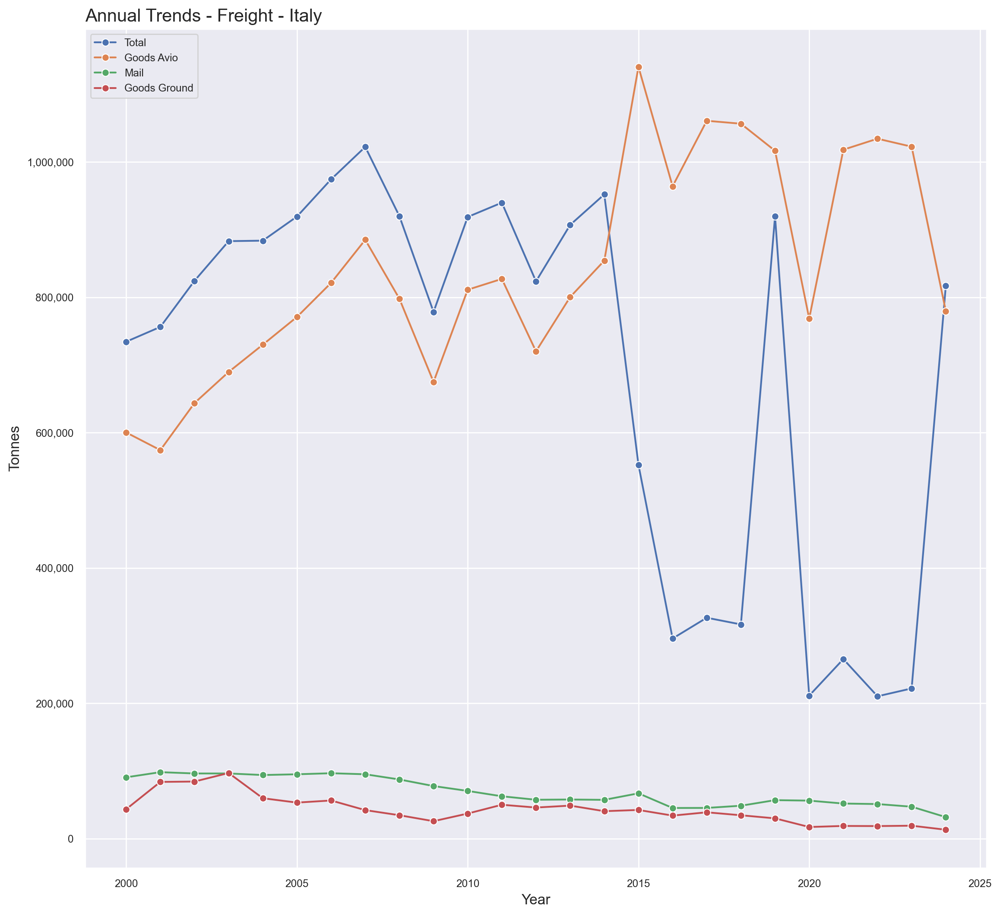

In [15]:
# plot the time series for annual freight
fig, ax = plt.subplots(figsize = (12,12))
plt.title('Annual Trends - Freight - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Tonnes', fontsize = 12)
plt.xlabel('Year', fontsize = 12)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

sns.lineplot(data=fre_tot_year, x='Year', y='FRE - Total', marker='o', label='Total')
sns.lineplot(data=fre_avio_year, x='Year', y='FRE - Goods Avio', marker='o', label='Goods Avio')
sns.lineplot(data=fre_mail_year, x='Year', y='FRE - Mail', marker='o', label='Mail')
sns.lineplot(data=fre_grnd_year, x='Year', y='FRE - Goods Ground', marker='o', label='Goods Ground')

plt.legend(loc="upper left")
plt.show()

**Goods Avio** generally shows an upward trend, although there are several fluctuations: it peaked in 2015 and its lows are linked to years of economic downturns.    
**Mail** and **Goods Ground** have significantly lower levels of activity and show a negative trend.   
  
  <br/><br/>



In [ ]:
# comments to be added


# the TOTAL FREIGHT trend line does not make sense after 2015

In [14]:
# define subsets for national monthly aircraft movements
mov_dom_month = df.groupby(['Year', 'Month'])['MOV - Domestic'].sum().reset_index()
mov_int_month = df.groupby(['Year', 'Month'])['MOV - International'].sum().reset_index()
mov_EU_month = df.groupby(['Year', 'Month'])['MOV - EU'].sum().reset_index()
mov_gen_month = df.groupby(['Year', 'Month'])['MOV - General Avio'].sum().reset_index()
mov_tot_month = df.groupby(['Year', 'Month'])['MOV - Total'].sum().reset_index()

# define subsets for national monthly passengers
pax_dom_month = df.groupby(['Year', 'Month'])['PAX - Domestic'].sum().reset_index()
pax_int_month = df.groupby(['Year', 'Month'])['PAX - International'].sum().reset_index()
pax_EU_month = df.groupby(['Year', 'Month'])['PAX - EU'].sum().reset_index()
pax_trs_month = df.groupby(['Year', 'Month'])['PAX - Transit'].sum().reset_index()
pax_gen_month = df.groupby(['Year', 'Month'])['PAX - General Avio'].sum().reset_index()
pax_tot_month = df.groupby(['Year', 'Month'])['PAX - Total'].sum().reset_index()

# define subsets for national monthly freight
fre_avio_month = df.groupby(['Year', 'Month'])['FRE - Goods Avio'].sum().reset_index()
fre_grnd_month = df.groupby(['Year', 'Month'])['FRE - Goods Ground'].sum().reset_index()
fre_mail_month = df.groupby(['Year', 'Month'])['FRE - Mail'].sum().reset_index()
fre_tot_month = df.groupby(['Year', 'Month'])['FRE - Total'].sum().reset_index()

In [15]:
# create colour mapping based on all unique values of year
years = df.index.year.unique()
colours = sns.color_palette('hsv', n_colors=len(years))  # get a number of colours
cmap = dict(zip(years, colours))  # zip values to colours

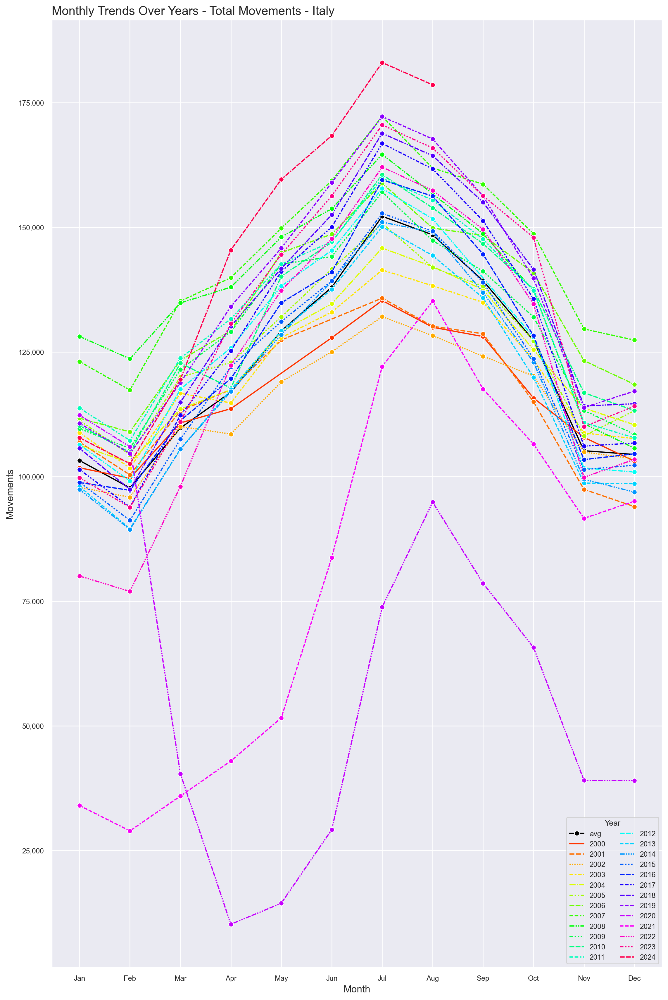

In [16]:
# plot the time series for monthly total movements
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Total Movements - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Movements', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=mov_tot_month, x='Month', y='MOV - Total', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=mov_tot_month, x='Month', y='MOV - Total', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="lower right", bbox_to_anchor=(1, 0), ncol=2)

plt.show()

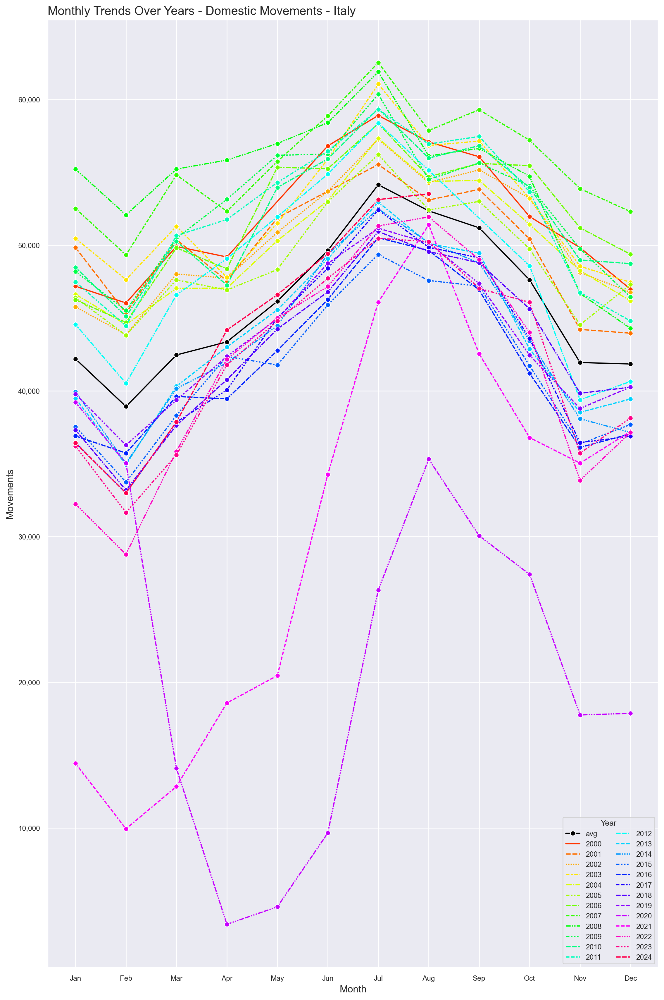

In [17]:
# plot the time series for monthly domestic movements
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Domestic Movements - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Movements', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=mov_dom_month, x='Month', y='MOV - Domestic', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=mov_dom_month, x='Month', y='MOV - Domestic', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="lower right", bbox_to_anchor=(1, 0), ncol=2)

plt.show()

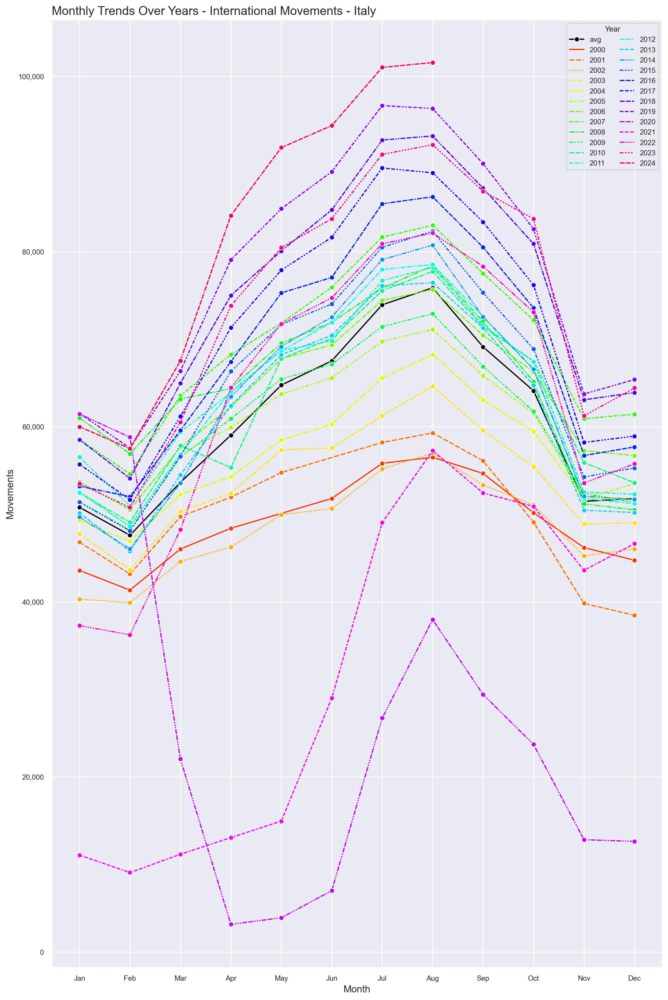

In [18]:
# plot the time series for monthly international movements
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - International Movements - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Movements', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=mov_int_month, x='Month', y='MOV - International', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=mov_int_month, x='Month', y='MOV - International', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)

plt.show()

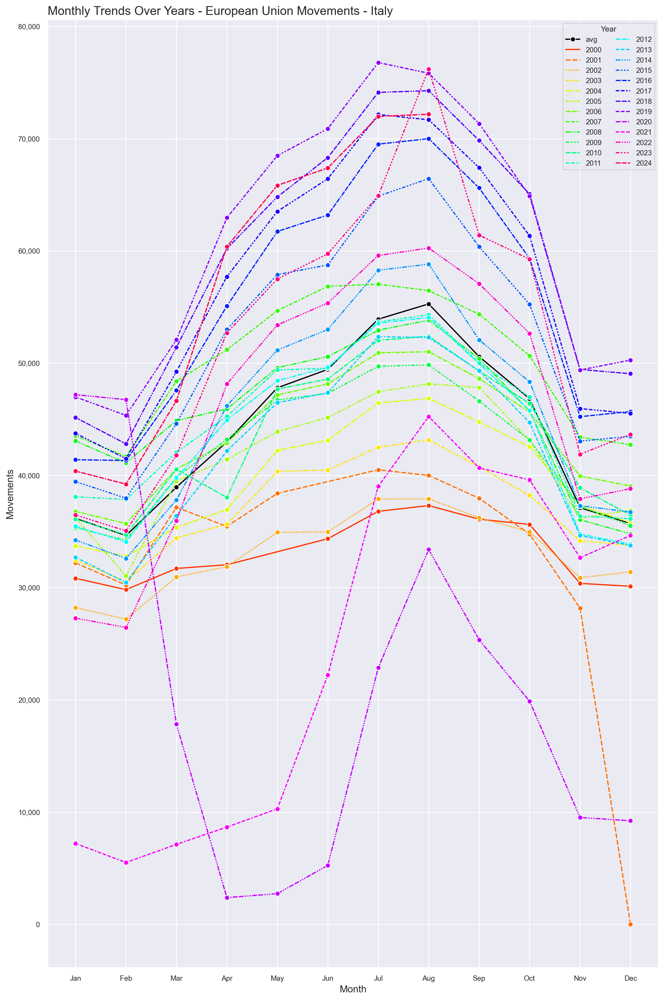

In [19]:
# plot the time series for monthly EU movements
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - European Union Movements - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Movements', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=mov_EU_month, x='Month', y='MOV - EU', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=mov_EU_month, x='Month', y='MOV - EU', hue='Year', style='Year', palette=cmap, marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)

plt.show()

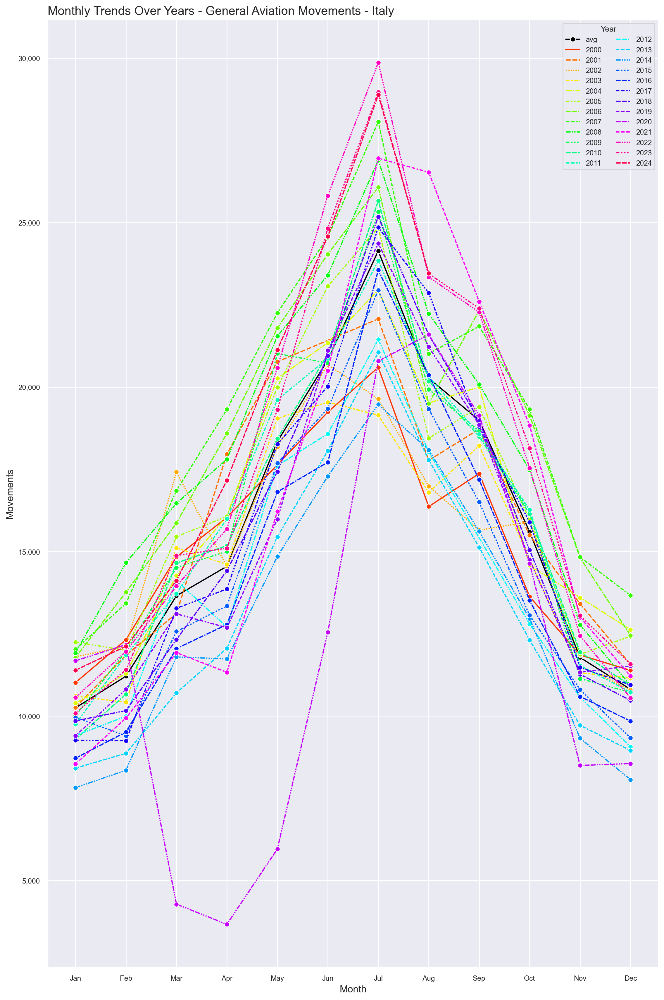

In [20]:
# plot the time series for monthly general aviation movements
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - General Aviation Movements - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Movements', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=mov_gen_month, x='Month', y='MOV - General Avio', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=mov_gen_month, x='Month', y='MOV - General Avio', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)

plt.show()

In [ ]:
# comments to be added




In [ ]:
#

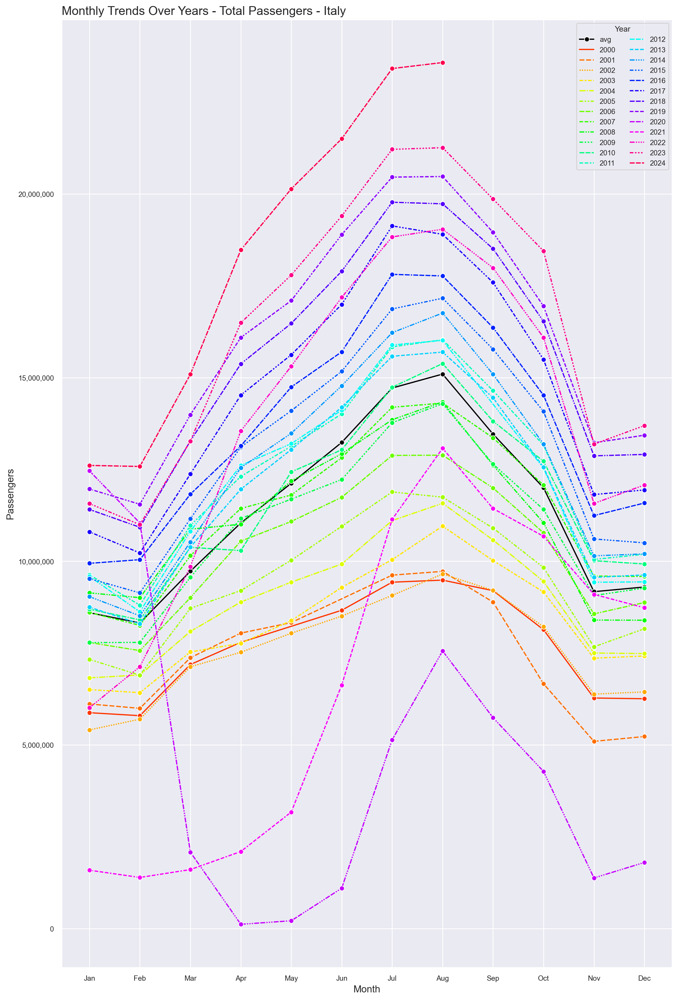

In [21]:
# plot the time series for monthly total passengers
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Total Passengers - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Passengers', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=pax_tot_month, x='Month', y='PAX - Total', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=pax_tot_month, x='Month', y='PAX - Total', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

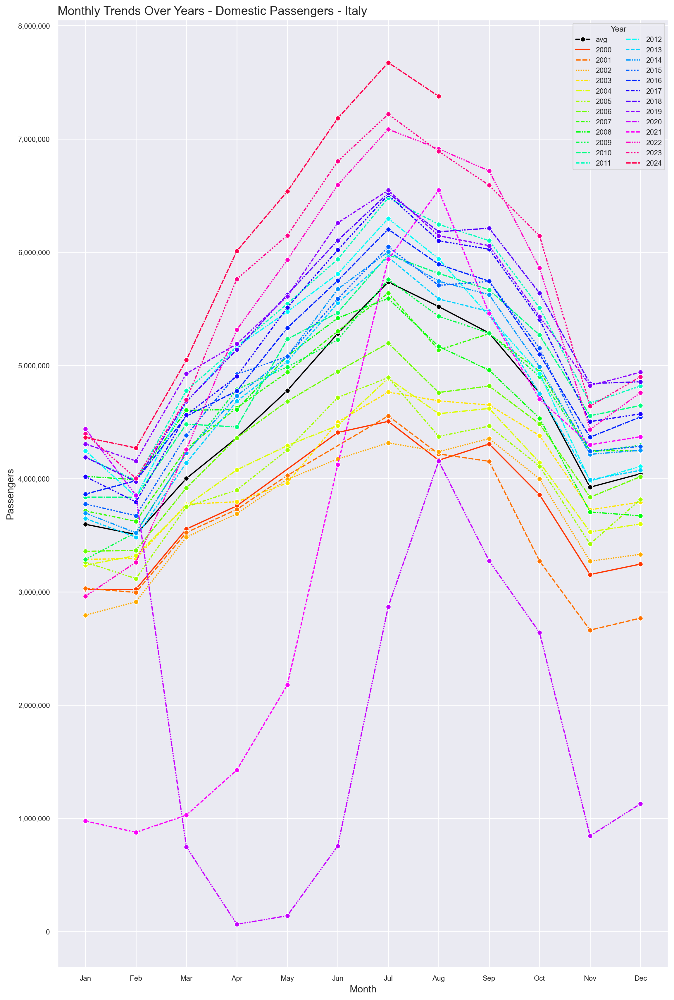

In [22]:
# plot the time series for monthly domestic passengers
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Domestic Passengers - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Passengers', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=pax_dom_month, x='Month', y='PAX - Domestic', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=pax_dom_month, x='Month', y='PAX - Domestic', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

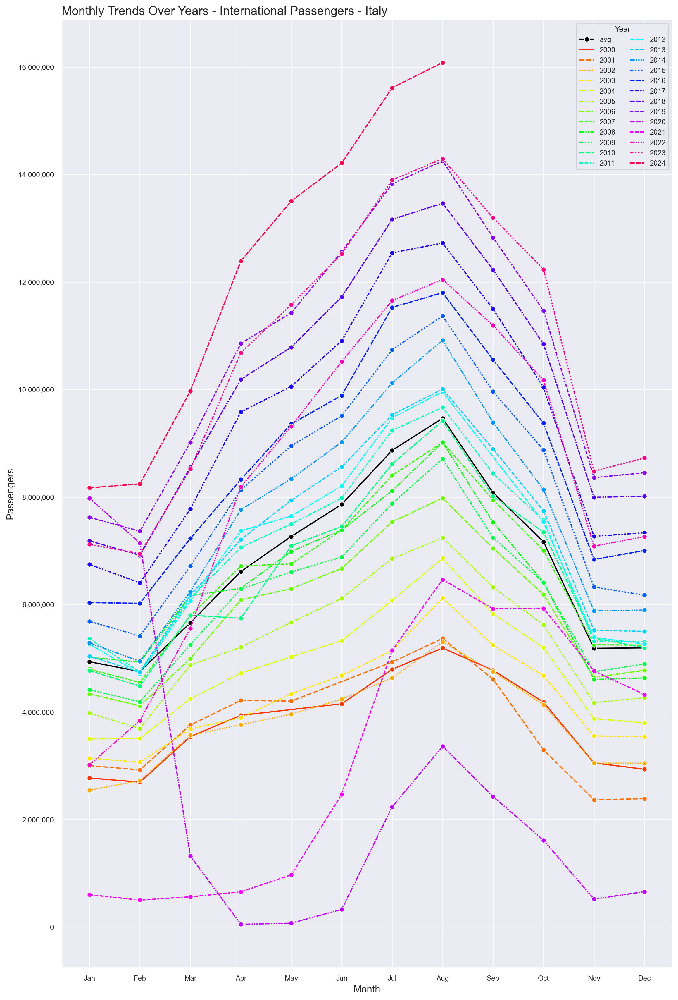

In [23]:
# plot the time series for monthly international passengers
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - International Passengers - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Passengers', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=pax_int_month, x='Month', y='PAX - International', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=pax_int_month, x='Month', y='PAX - International', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

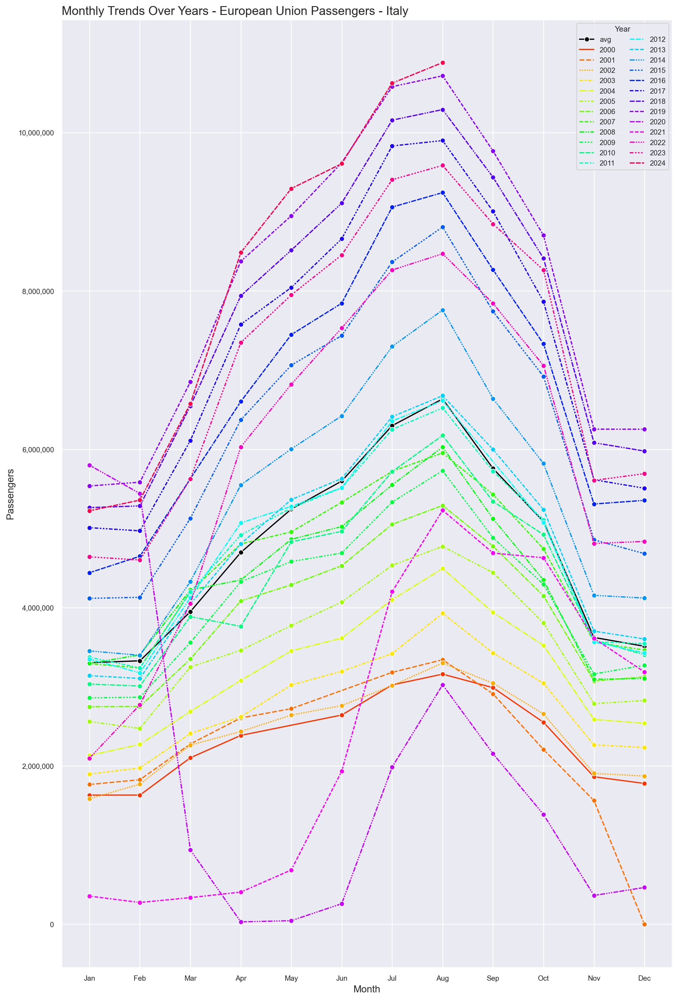

In [24]:
# plot the time series for monthly EU passengers
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - European Union Passengers - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Passengers', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=pax_EU_month, x='Month', y='PAX - EU', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=pax_EU_month, x='Month', y='PAX - EU', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

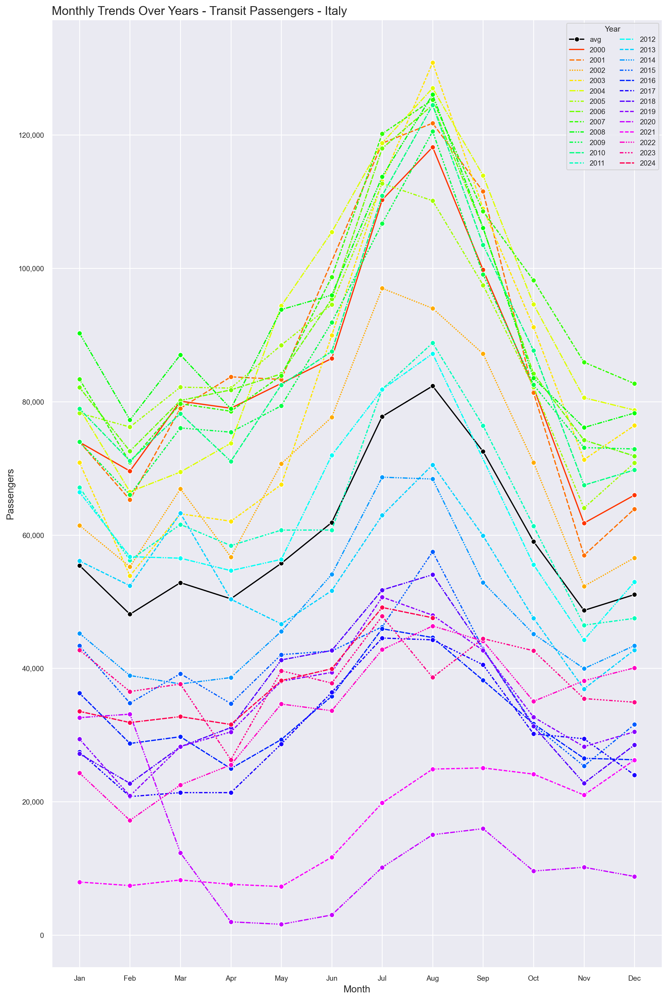

In [25]:
# plot the time series for monthly transit passengers
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Transit Passengers - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Passengers', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=pax_trs_month, x='Month', y='PAX - Transit', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=pax_trs_month, x='Month', y='PAX - Transit', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

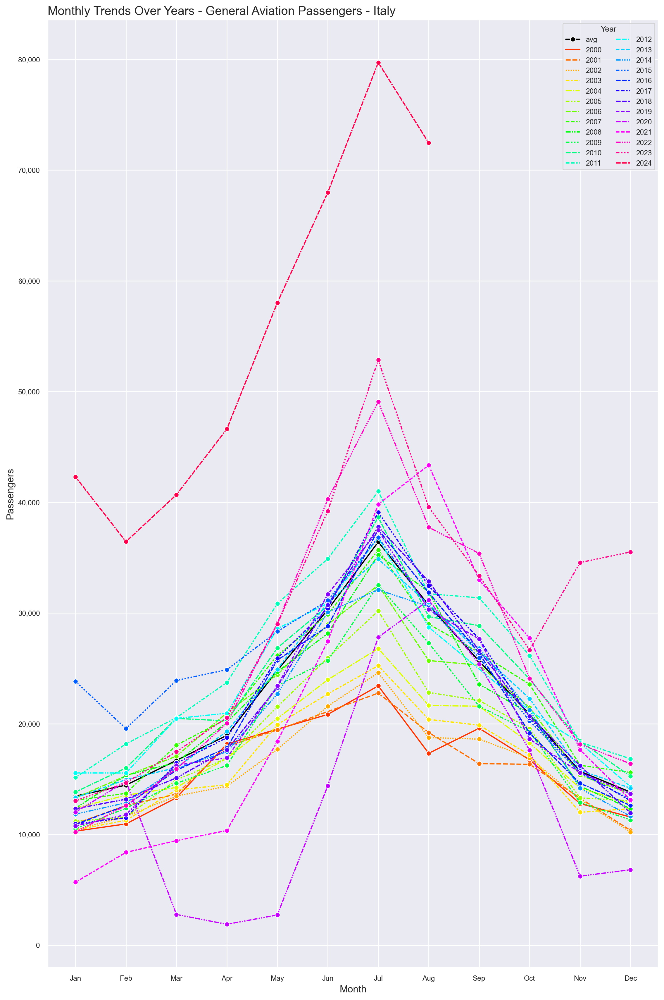

In [26]:
# plot the time series for monthly general aviation passengers
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - General Aviation Passengers - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Passengers', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=pax_gen_month, x='Month', y='PAX - General Avio', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=pax_gen_month, x='Month', y='PAX - General Avio', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

In [ ]:
# comments to be added




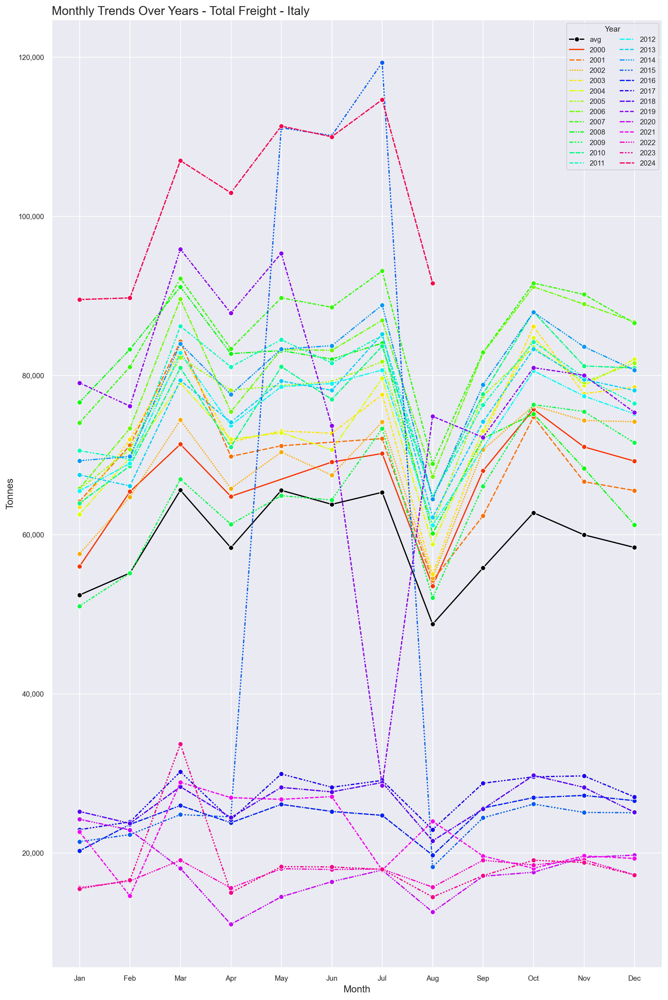

In [27]:
# plot the time series for monthly total freight 
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Total Freight - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Tonnes', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=fre_tot_month, x='Month', y='FRE - Total', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=fre_tot_month, x='Month', y='FRE - Total', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

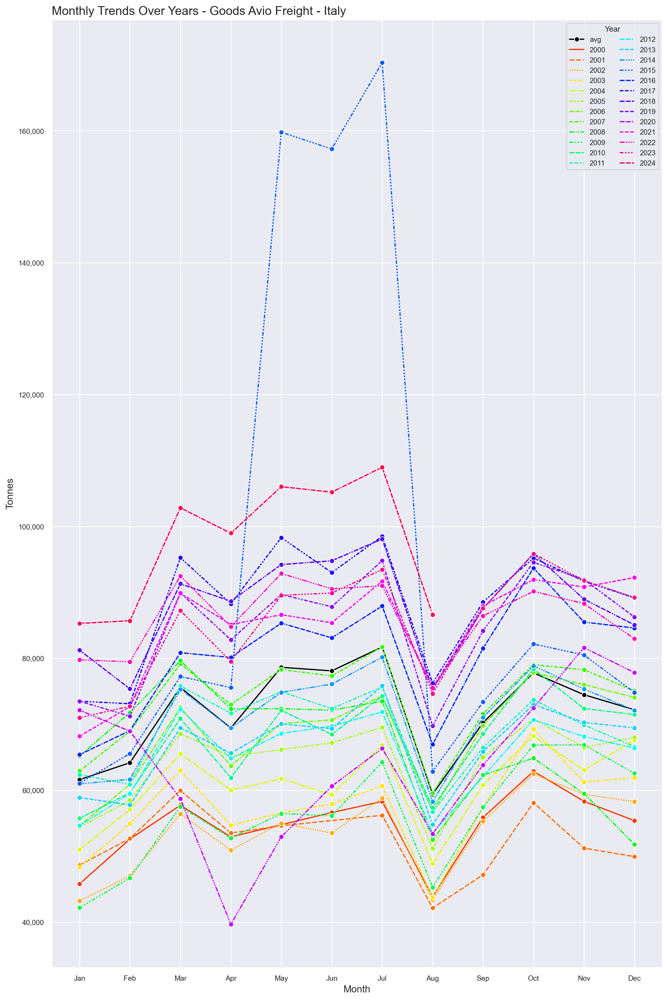

In [28]:
# plot the time series for monthly goods avio freight 
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Goods Avio Freight - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Tonnes', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=fre_avio_month, x='Month', y='FRE - Goods Avio', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=fre_avio_month, x='Month', y='FRE - Goods Avio', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

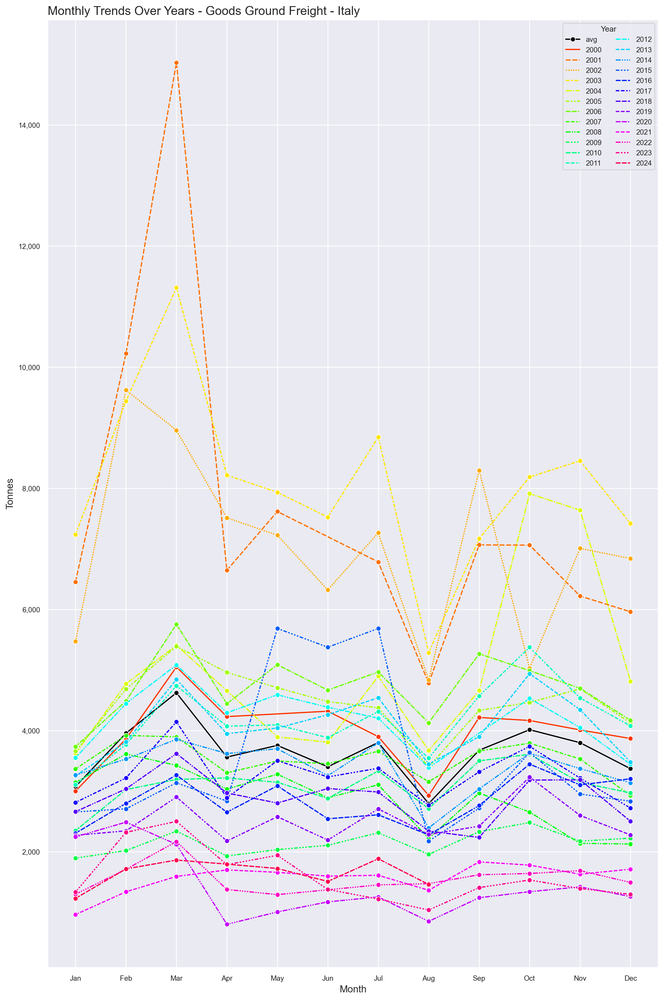

In [29]:
# plot the time series for monthly goods ground freight 
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Goods Ground Freight - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Tonnes', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=fre_grnd_month, x='Month', y='FRE - Goods Ground', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=fre_grnd_month, x='Month', y='FRE - Goods Ground', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

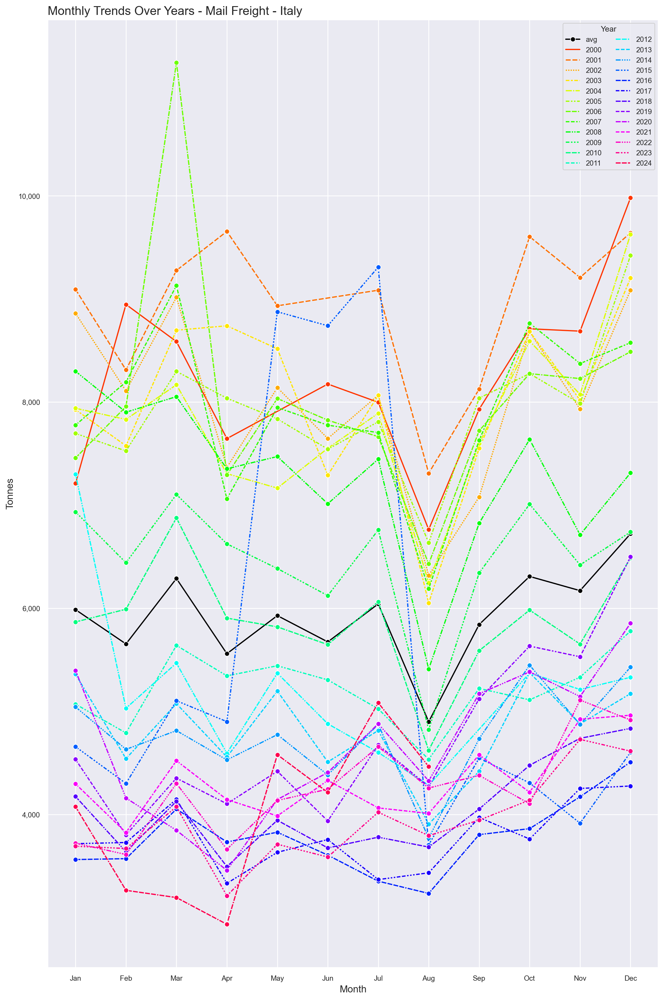

In [30]:
# plot the time series for monthly mail freight 
fig, ax = plt.subplots(figsize = (12,20))
plt.title('Monthly Trends Over Years - Mail Freight - Italy', loc='left', fontsize = 15)
plt.xticks(rotation = 0)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Tonnes', fontsize = 12)
plt.xlabel('Month', fontsize = 12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
ax.get_yaxis().set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

p = sns.lineplot(data=fre_mail_month, x='Month', y='FRE - Mail', color='black', ci=None, marker='o',
                 label='avg', ax=ax)
p = sns.lineplot(data=fre_mail_month, x='Month', y='FRE - Mail', hue='Year', style='Year', palette=cmap,
                 marker='o', ax=ax)
sns.move_legend(p, loc="upper right", bbox_to_anchor=(1, 1), ncol=2)
plt.show()

In [ ]:
# comments to be added




In [ ]:
# define subsets by dimensional class
df_sml = df[df['Dimension'] == 'Small']
df_sme = df[df['Dimension'] == 'Small-Medium']
df_med = df[df['Dimension'] == 'Small']
df_mla = df[df['Dimension'] == 'Medium-Large']
df_lrg = df[df['Dimension'] == 'Large']

In [40]:
may_flights = df.query("Month == 5")
AOI_flights = df.query("Code == 'AOI'")